In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from copy import deepcopy
import re
import nltk
import string
from nltk.corpus import stopwords
from nltk.stem import WordNetLemmatizer
nltk.download('stopwords')
nltk.download('wordnet')
from sklearn.model_selection import train_test_split,GridSearchCV
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.naive_bayes import MultinomialNB
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score
from sklearn.neural_network import MLPClassifier

[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\JeeJoo\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\JeeJoo\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


In [2]:
#nltk.download('omw-1.4')

In [3]:
#currently only 900 rows each. we can probably search for more niche terms similar to the 3 roles and add these roles inside the data files

data_eng = pd.read_csv('../src/output/data-engineer_28-03-2023.csv',encoding= 'unicode_escape')
data_sci = pd.read_csv('../src/output/data-science_27-03-2023.csv',encoding= 'unicode_escape')
data_an = pd.read_csv('../src/output/data-analyst_28-03-2023.csv',encoding= 'unicode_escape')
data_an.head()

,companyName,company_starRating,company_offeredRole,company_roleLocation,company_salary,listing_jobDesc,requested_url
0,J&T EXPRESS SINGAPORE PTE. LTD.,2.5,Junior Data Analyst,Singapore,3000 - 3000,"Collect and clean data from various sources, e...",https://www.glassdoor.sg/partner/jobListing.ht...
1,ATT DIGIVERSE PTE. LTD.,NaN,Data Analyst [Junior],Singapore,4000 - 6000,Work with business users and data platform tea...,https://www.glassdoor.sg/partner/jobListing.ht...
2,TRUST RECRUIT PTE. LTD.,5.0,"Data Analyst ( Data Modeling , Data Analysis ,...",Singapore,5000 - 6000,Provide data analysis and insights to Product ...,https://www.glassdoor.sg/partner/jobListing.ht...
3,ARYAN SOLUTIONS PTE. LTD.,4.2,Junior Data Analyst,Singapore,4000 - 8000,Place client value and human experience at the...,https://www.glassdoor.sg/partner/jobListing.ht...
4,TRUST RECRUIT PTE. LTD.,5.0,Data Analyst (Tableau/ PowerBI/ R/ Python/ In ...,Singapore,5000 - 6000,Provide data analysis and insights to Product ...,https://www.glassdoor.sg/partner/jobListing.ht...


In [4]:
#Assign y-role based on csv files

data_eng['y_role'] = 'data_engineer'
data_sci['y_role'] = 'data_science'
data_an['y_role'] = 'data_analyst'



In [5]:
#Average company salary based on the range,and fill NA with average of each job type

def fn(x):
    if x == 0 :
        return 0
    else:
        s = x.split(' - ')
        s = sum(map(int,s))/len(s)
        if s > 40000: #if salary > 40000, assume its yearly so divide by 12
            s = s//12
        return s

data_eng['company_salary'] = data_eng['company_salary'] .replace(np.nan,0)
data_sci['company_salary'] = data_sci['company_salary'] .replace(np.nan,0)
data_an['company_salary'] = data_an['company_salary'] .replace(np.nan,0)
data_eng['company_salary'] = data_eng['company_salary'].apply(fn)
data_sci['company_salary'] = data_sci['company_salary'].apply(fn)
data_an['company_salary'] = data_an['company_salary'].apply(fn)

#get average based on job type
#data_eng_avg = data_eng['company_salary'].mean()
#data_sci_avg = data_sci['company_salary'].mean()
#data_an_avg = data_an['company_salary'].mean()
#data_eng['company_salary'] = data_eng['company_salary'] .replace(0,data_eng_avg)
#data_sci['company_salary'] = data_sci['company_salary'] .replace(0,data_sci_avg)
#data_an['company_salary'] = data_an['company_salary'] .replace(0,data_an_avg)

data_raw1 = data_eng.append(data_sci).append(data_an)


<ipython-input-5-608fcdabdf35>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  data_raw1 = data_eng.append(data_sci).append(data_an)


In [6]:
data_raw1['listing_jobDesc'] = data_raw1['listing_jobDesc'].astype(str)
data_raw1.dtypes

companyName              object
company_starRating      float64
company_offeredRole      object
company_roleLocation     object
company_salary          float64
listing_jobDesc          object
requested_url            object
y_role                   object
dtype: object

In [7]:
#FE codes taken form JED
def process_job_description(job_description):
    """
    Takes in a job description and returns a string with stop words, irrelevant words, punctuation, and
    lemmatized words removed. The function converts the job description to lowercase, removes punctuation
    using string.punctuation, and splits it into words. Then, it removes any stop words using NLTK's list
    of English stop words and lemmatizes the remaining words using NLTK's WordNetLemmatizer.
    """
    job_description = job_description.lower()
    job_description = job_description.translate(str.maketrans('', '', string.punctuation))
    words = job_description.split()
    stop_words = set(stopwords.words('english'))
    lemmatizer = WordNetLemmatizer()
    relevant_words = [lemmatizer.lemmatize(word) for word in words if word not in stop_words]
    return ' '.join(relevant_words)

def process_salary(salary):
    """
    Process the salary information and return the average monthly salary as an integer.
    If salary is not a string, it is returned unchanged.
    If salary is a string, it is first checked if it is a range (e.g. "10000 - 20000").
    If it is a range, the low and high values are extracted and converted to monthly salary if necessary (if high >= 36000).
    The average monthly salary is then computed as (low + high) // 2 and returned as an integer.
    If salary is not a range, it is assumed to be a single value and is converted to an integer and returned.
    """
    if isinstance(salary, str):
        # Check if salary is a range
        if re.match(r'\d+ - \d+', salary):
            low, high = map(int, salary.split(' - '))
            # Convert to monthly salary if yearly
            if high >= 36000:
                low //= 12
                high //= 12
            return (low + high) // 2
        else:
            salary = int(salary)
            # Convert to monthly salary if yearly
            if salary >= 36000:
                salary //= 12
            return salary
    else:
        return salary

In [8]:
data_raw1["cleaned_listing_jobDesc"] = data_raw1["listing_jobDesc"].apply(process_job_description)
data_raw1["Monthly_Salary"] = data_raw1["company_salary"].apply(process_salary)

In [9]:
#### sns.set(rc={'figure.figsize':(15,25)})
#sns.displot(data = data_raw1,x = 'company_salary',row = 'y_role',height = 6,aspect=2)
#plt.show()

In [10]:
#get average based on job type
data_eng_avg = data_eng['company_salary'].mean()
data_sci_avg = data_sci['company_salary'].mean()
data_an_avg = data_an['company_salary'].mean()
data_eng['company_salary'] = data_eng['company_salary'] .replace(0,data_eng_avg)
data_sci['company_salary'] = data_sci['company_salary'] .replace(0,data_sci_avg)
data_an['company_salary'] = data_an['company_salary'] .replace(0,data_an_avg)

data_raw = data_eng.append(data_sci).append(data_an)
#deepcopy(data_raw1)

#data_raw['listing_jobDesc'][0].values

<ipython-input-10-c3ed2e90c707>:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  data_raw = data_eng.append(data_sci).append(data_an)


C:\Users\JeeJoo\AppData\Roaming\Python\Python38\site-packages\seaborn\distributions.py:244: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  baselines.iloc[:, cols] = (curves


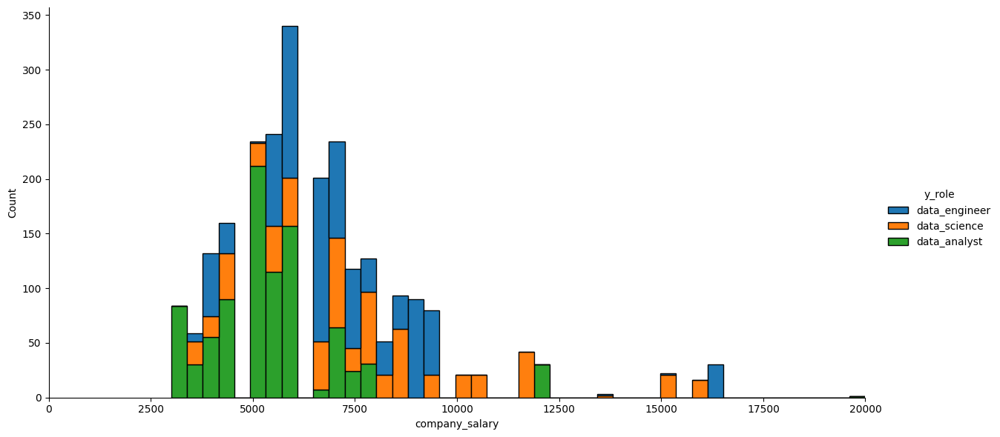

In [11]:
#plot with new data replacing 0 with average of job that we have
#sns.color_palette("Set2")
sns.displot(data = data_raw,x = 'company_salary',hue = 'y_role',height = 6,aspect=2,multiple='stack',alpha=1)
plt.xlim(0,20000)
plt.show()

In [12]:
def is_valid_date(date_str): # sub function
    try:
        parser.parse(date_str)
        return True
    except:
        return False
    
def date_removal(data):
    new_list = [' '.join([w for w in line.split() if not is_valid_date(w)]) for line in data]
    return (new_list[0])

def stemmer_and_stopWord(doc):    
    doc= nlp(doc)
    token_list = []
    for token in doc:
      lemma = token.lemma_
      if lemma == '-PRON-' or lemma == 'be':
        lemma = token.text
      token_list.append(lemma)

    stemmed = token_list
    
    # Create list of word tokens after removing stopwords
    
    filtered_sentence =[] 
    for word in stemmed:
        lexeme = nlp.vocab[word]
        if lexeme.is_stop == False:
            filtered_sentence.append(word)
    return (' '.join(filtered_sentence))

def normaliz(filtered_sentence):
        
    words = [str(word).lower() for word in filtered_sentence.split()]
    return  ' '.join(words[:100])

# For number removal ~

def numbers_removal(data):
    s = [data]
    result = ''.join([i for i in s if not i.isdigit()])
    return (result)
# For punchuation & double white spaces ~

def punch_removal(words):
    table = str.maketrans('', '', string.punctuation)
    stripped = [w.translate(table) for w in [words]]
    return re.sub(' +', ' ', stripped[0])


def cleaner(data):
    string = [data]
    string = date_removal(string)
    #string = numbers_removal(string)
    string = punch_removal(string)
    string = stemmer_and_stopWord(string)
    #string = normaliz(string)
    return string

Text processing referenced from https://www.kaggle.com/code/adarshsng/predicting-job-type-cat-using-job-description#Modeling-:---%3E

## Check wordcount info referenced from kaggle
#### Ignore the codes below until the next header

In [11]:
#! pip install langdetect
#! pip install translate
#! pip install gensim
#! python -m spacy download en_core_web_lg

In [12]:
import spacy.cli
#spacy.cli.download("en_core_web_lg")
import en_core_web_lg
nlp = en_core_web_lg.load()

In [13]:
#text processing
from dateutil import parser
import string
import re
import nltk
nltk.download('punkt')
nltk.download('wordnet')
from nltk.stem.porter import PorterStemmer
from spacy.lang.en.stop_words import STOP_WORDS

from gensim.models import KeyedVectors

## for language detection
## warnings !!
import warnings
warnings.filterwarnings('ignore')

[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\JeeJoo\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\JeeJoo\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


In [58]:
data_types_dict = {'companyName':str,'company_starRating':float,'company_offeredRole':str,'company_roleLocation':str,'company_salary':float,'listing_jobDesc':str,'requested_url':str,'y_role':str}
data_raw.dtypes
data_raw = data_raw.astype(data_types_dict)
#data_raw.dtypes
#data_raw['listing_jobDesc']
#data_raw['listing_jobDesc'][0].values

In [15]:
#focusing on job description !!!

# Steps to be taken :
#
#     1. Text pre-processing:
#         1.1 Normalize case
#         1.2 Special character
#         1.3 Stop words
#         1.4 White space
#         1.5 Stemming
        
#     2. Feature extraction:
#         2.1 Word2vec embedding

In [16]:
print('* --------------- for raw data --------------- *')

lst=[]
for i in data_raw['listing_jobDesc']: # cleansing !!
    lst.append(cleaner(i))

data_raw['listing_jobDesc']=pd.Series(lst) # updating the attributee !!

#print('* --------------- for test data --------------- *')

#list=[]
#for i in test['job_description']: # cleansing !!
#    list.append(cleaner(i))

#test['job_description']=pd.Series(list) # updating the attributee !!

* --------------- for raw data --------------- *


In [59]:
#data_raw['listing_jobDesc'][0].values

* ------------------------- for train data-------------------------------- *


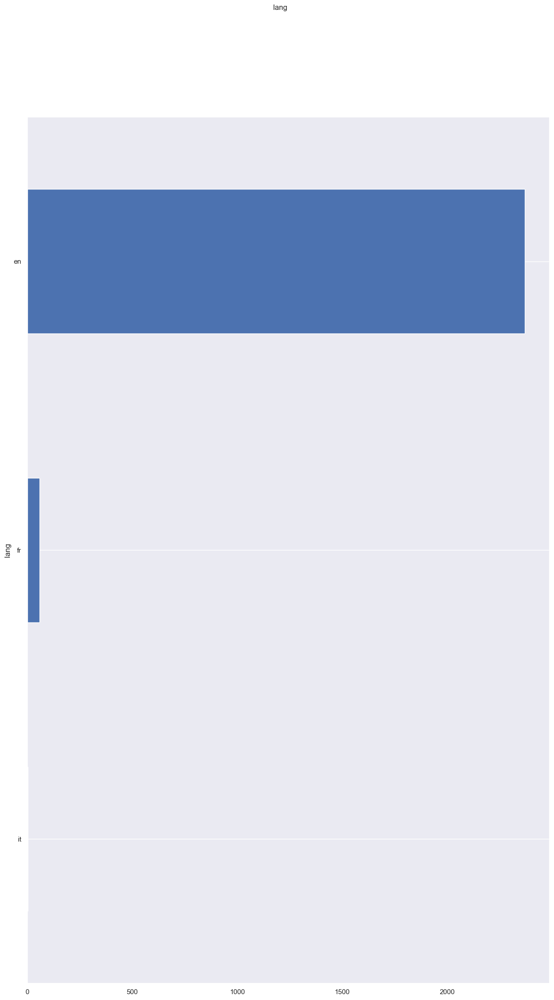

In [18]:
# adding a new attribute for differencing the language of teh 'job_description' !!
import langdetect

print('* ------------------------- for train data-------------------------------- *')

data_raw['lang'] = data_raw["listing_jobDesc"].apply(lambda x: langdetect.detect(x) if x.strip() != "" else "")

fig, ax = plt.subplots()
fig.suptitle('lang', fontsize=12)

data_raw['lang'].reset_index().groupby('lang').count().sort_values(by= "index").plot(kind="barh", legend=False, ax=ax).grid(axis='x')
plt.show()

#print('* -------------------------- for test data ------------------------------- *')

#test['lang'] = test["job_description"].apply(lambda x: langdetect.detect(x) if x.strip() != "" else "")

#fig, ax = plt.subplots()
#fig.suptitle('lang', fontsize=12)
#test['lang'].reset_index().groupby('lang').count().sort_values(by= "index").plot(kind="barh", legend=False, ax=ax).grid(axis='x')
#plt.show()

In [19]:
# Feature Extraction from the job discription :

print('* ------------------------- for train data-------------------------------- *')

# the relevance of these feature will be tested on the later stages !!

data_raw['word_count'] = data_raw["listing_jobDesc"].apply(lambda x: 
                                                     len(str(x).split(" ")))
data_raw['char_count'] = data_raw["listing_jobDesc"].apply(lambda x:
                                                     sum(len(word) 
                                                     for word in str(x).split(" ")))
data_raw['sentence_count'] = data_raw["listing_jobDesc"].apply(lambda x: 
                                                         len(str(x).split(".")))
data_raw['avg_word_length'] = data_raw['char_count'] / data_raw['word_count']
data_raw['avg_sentence_lenght'] = data_raw['word_count'] / data_raw['sentence_count']

#print('* ------------------------- for test data-------------------------------- *')

#test['word_count'] = test["job_description"].apply(lambda x: 
                                                   #len(str(x).split(" ")))
#test['char_count'] = test["job_description"].apply(lambda x: 
                                                   #sum(len(word) 
                                                   #for word in str(x).split(" ")))
#test['sentence_count'] = test["job_description"].apply(lambda x: 
                                                    #len(str(x).split(".")))
#test['avg_word_length'] = test['char_count'] / test['word_count']
#test['avg_sentence_lenght'] = test['word_count'] / test['sentence_count']

* ------------------------- for train data-------------------------------- *


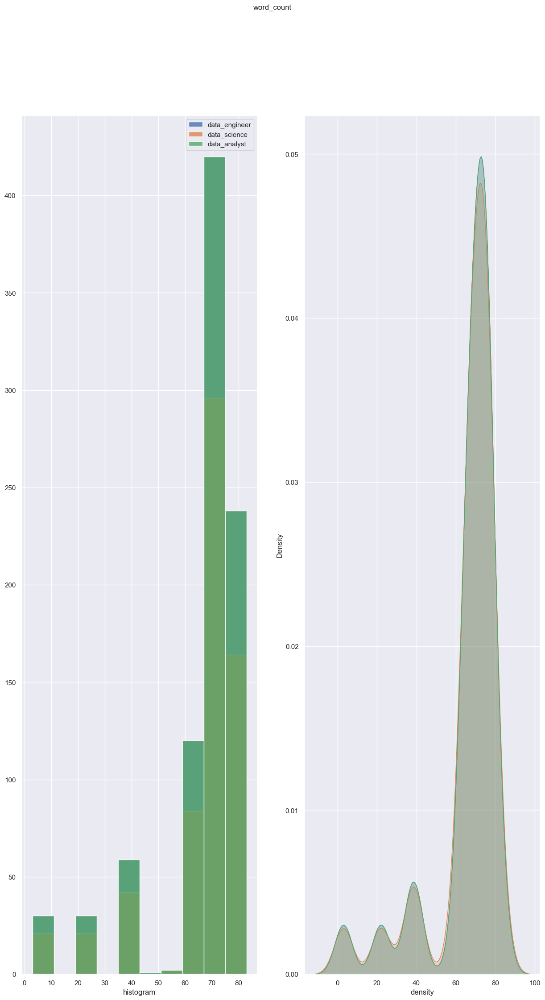

In [20]:
# A bivariate distributions to look at the correlation of a attribute with the target class !!

## conclusion : The categories have a similar length distribution but the samples have different sizes.

x = 'word_count'
y = 'y_role'

fig, ax = plt.subplots(nrows=1, ncols=2)
fig.suptitle(x, fontsize=12)
for i in data_raw[y].unique():
    sns.distplot(data_raw[data_raw[y]==i][x], hist=True, kde=False, 
                 bins=10, hist_kws={"alpha":0.8}, 
                 axlabel="histogram", ax=ax[0])
    sns.distplot(data_raw[data_raw[y]==i][x], hist=False, kde=True, 
                 kde_kws={"shade":True}, axlabel="density",   
                 ax=ax[1])
ax[0].grid(True)
ax[0].legend(data_raw[y].unique())
ax[1].grid(True)
plt.show()

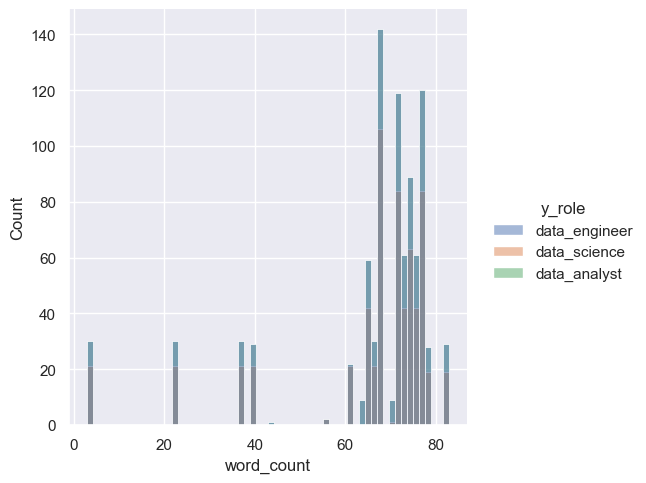

In [21]:
x = 'word_count'
y = 'y_role'
sns.displot(data_raw, x = x, hue = 'y_role')
plt.show()

In [ ]:
import re
data_raw['clean_job_desc']=data_raw['listing_jobDesc'].apply(lambda x: re.sub(r'[^\w\s]', '', x.lower()))
data_raw['clean_job_desc'] = data_raw['clean_job_desc'].apply(lambda x: re.sub(r'\d+', '', x))
data_raw['tokens'] = data_raw['clean_job_desc'].apply(lambda x: x.split())
#data_raw['clean_job_desc']

In [23]:
from collections import Counter
data_raw['word_count'] = data_raw['tokens'].apply(lambda x: Counter(x))
data_raw.head()
df = data_raw[['y_role','word_count']].copy()

dff = pd.DataFrame(columns = ['JobType','Word','Frequency'])

for index, row in df.iterrows():
    job_type = row['y_role']
    word_dict = row['word_count']
    for w,f in word_dict.items():
        dff = dff.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)

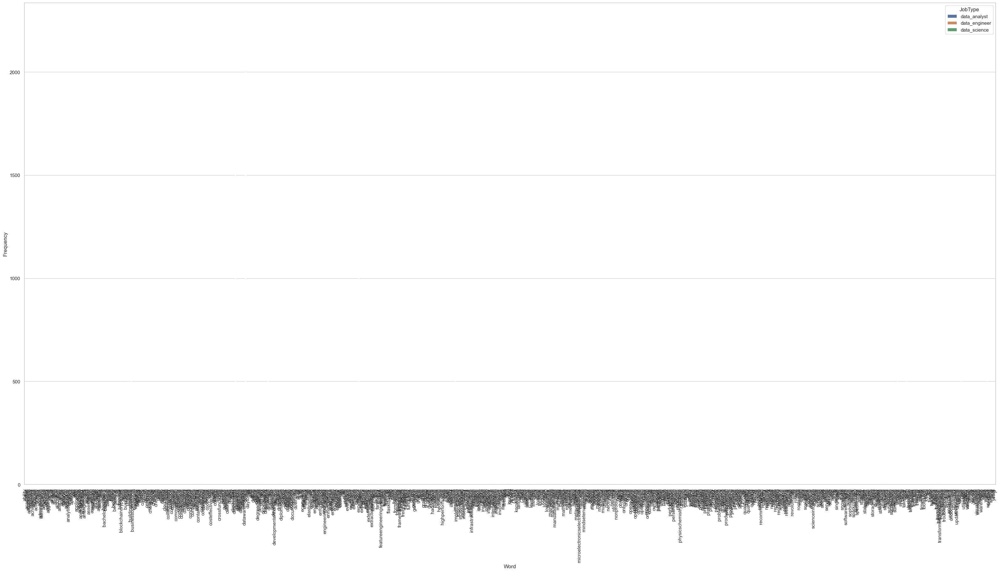

In [24]:
#group and sum frequency
grouped_data = dff.groupby(['JobType', 'Word'], as_index=False)['Frequency'].sum()

sns.set(style="whitegrid")
plt.figure(figsize=(40, 20))
sns.barplot(x='Word', y='Frequency', hue='JobType', data=grouped_data)
plt.xlabel('Word')
plt.ylabel('Frequency')
plt.xticks(rotation=90)
plt.show()

## Check job description based on key words/skills list (since previous code above not much insights)

In [13]:
#try grouping by key words
###
###
data_r = deepcopy(data_raw1)
data_r.head()

skills_lst = ['sql','python','nosql','postgresql','redshift','athena','tableau','power bi','excel','data visualization','dashboards','machine learning','scala','java','javascript','html','c++','hive','aws','tensorflow','pytorch','flask','plumber','ai','keras','matlab','data scraping',
              'nlp','powerpoint','etl','azure','linux','spark','hadoop','docker','kubernetes','numpy','postgresql','query']



In [14]:
data_r.head()

,companyName,company_starRating,company_offeredRole,company_roleLocation,company_salary,listing_jobDesc,requested_url,y_role,cleaned_listing_jobDesc,Monthly_Salary
0,Incube8 Pte Ltd,3.9,Data Engineer (Data Science),Novena,7500.0,"Maintain, build and iteratively improve existi...",https://www.glassdoor.sg/partner/jobListing.ht...,data_engineer,maintain build iteratively improve existing da...,7500.0
1,TRINITY CONSULTING SERVICES PTE. LTD.,4.1,Data Engineer,Singapore,7000.0,"Bachelors degree/Diploma in Computer Science,...",https://www.glassdoor.sg/partner/jobListing.ht...,data_engineer,bachelors degreediploma computer science comp...,7000.0
2,ELLIOTT MOSS CONSULTING PTE. LTD.,3.0,Data Engineer,Singapore,8000.0,The candidate for the Senior Data Engineer rol...,https://www.glassdoor.sg/partner/jobListing.ht...,data_engineer,candidate senior data engineer role must appro...,8000.0
3,DYNAMIC HUMAN CAPITAL PTE. LTD.,3.9,Data Engineer,Singapore,6000.0,Cooperates with DevOps and Business Intelligen...,https://www.glassdoor.sg/partner/jobListing.ht...,data_engineer,cooperates devops business intelligence team e...,6000.0
4,SAKSOFT PTE LIMITED,3.7,Data Engineer,Singapore,9000.0,Minimum 8 years of extensive experience in dea...,https://www.glassdoor.sg/partner/jobListing.ht...,data_engineer,minimum 8 year extensive experience dealing da...,9000.0


In [15]:
data_types_dict = {'companyName':str,'company_starRating':float,'company_offeredRole':str,'company_roleLocation':str,'company_salary':float,'listing_jobDesc':str,'requested_url':str,'y_role':str}
data_r.dtypes
data_r = data_r.astype(data_types_dict)



In [16]:
def count_keywords(description):
    keyword_counts = {}
    for keyword in skills_lst:
        count = description.lower().count(keyword)
        keyword_counts[keyword] = count
    return keyword_counts

#data_r['clean_job_desc']=data_r['listing_jobDesc'].apply(lambda x: re.sub(r'[^\w\s]-', ' ', x.lower()))
#data_r['clean_job_desc'] = data_r['clean_job_desc'].apply(lambda x: re.sub(r'[^A-Za-z0-9]+', ' ', x))
#data_r['clean_job_desc'] = data_r['clean_job_desc'].apply(lambda x: re.sub(r'\d+', ' ', x))
#data_r['clean_job_desc'] = data_r['clean_job_desc'].apply(lambda x: re.sub(r'\n', ' ', x))

data_r['key_counts'] = data_r['cleaned_listing_jobDesc'].apply(count_keywords)
data_r['listing_jobDesc'][0].values

#data_r['cleaned_listing_jobDesc'][0].values
data_r.head()

,companyName,company_starRating,company_offeredRole,company_roleLocation,company_salary,listing_jobDesc,requested_url,y_role,cleaned_listing_jobDesc,Monthly_Salary,key_counts
0,Incube8 Pte Ltd,3.9,Data Engineer (Data Science),Novena,7500.0,"Maintain, build and iteratively improve existi...",https://www.glassdoor.sg/partner/jobListing.ht...,data_engineer,maintain build iteratively improve existing da...,7500.0,"{'sql': 2, 'python': 2, 'nosql': 0, 'postgresq..."
1,TRINITY CONSULTING SERVICES PTE. LTD.,4.1,Data Engineer,Singapore,7000.0,"Bachelors degree/Diploma in Computer Science,...",https://www.glassdoor.sg/partner/jobListing.ht...,data_engineer,bachelors degreediploma computer science comp...,7000.0,"{'sql': 2, 'python': 1, 'nosql': 0, 'postgresq..."
2,ELLIOTT MOSS CONSULTING PTE. LTD.,3.0,Data Engineer,Singapore,8000.0,The candidate for the Senior Data Engineer rol...,https://www.glassdoor.sg/partner/jobListing.ht...,data_engineer,candidate senior data engineer role must appro...,8000.0,"{'sql': 1, 'python': 1, 'nosql': 0, 'postgresq..."
3,DYNAMIC HUMAN CAPITAL PTE. LTD.,3.9,Data Engineer,Singapore,6000.0,Cooperates with DevOps and Business Intelligen...,https://www.glassdoor.sg/partner/jobListing.ht...,data_engineer,cooperates devops business intelligence team e...,6000.0,"{'sql': 3, 'python': 0, 'nosql': 1, 'postgresq..."
4,SAKSOFT PTE LIMITED,3.7,Data Engineer,Singapore,9000.0,Minimum 8 years of extensive experience in dea...,https://www.glassdoor.sg/partner/jobListing.ht...,data_engineer,minimum 8 year extensive experience dealing da...,9000.0,"{'sql': 1, 'python': 0, 'nosql': 0, 'postgresq..."


In [17]:
dff2 = pd.DataFrame(columns = ['JobType','Word','Frequency'])

for index, row in data_r.iterrows():
    job_type = row['y_role']
    word_dict = row['key_counts']
    for w,f in word_dict.items():
        dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_index=True)
<ipython-input-17-9054c7ecddae>:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dff2 = dff2.append({'JobType':job_type,'Word':w,'Frequency':f},ignore_inde

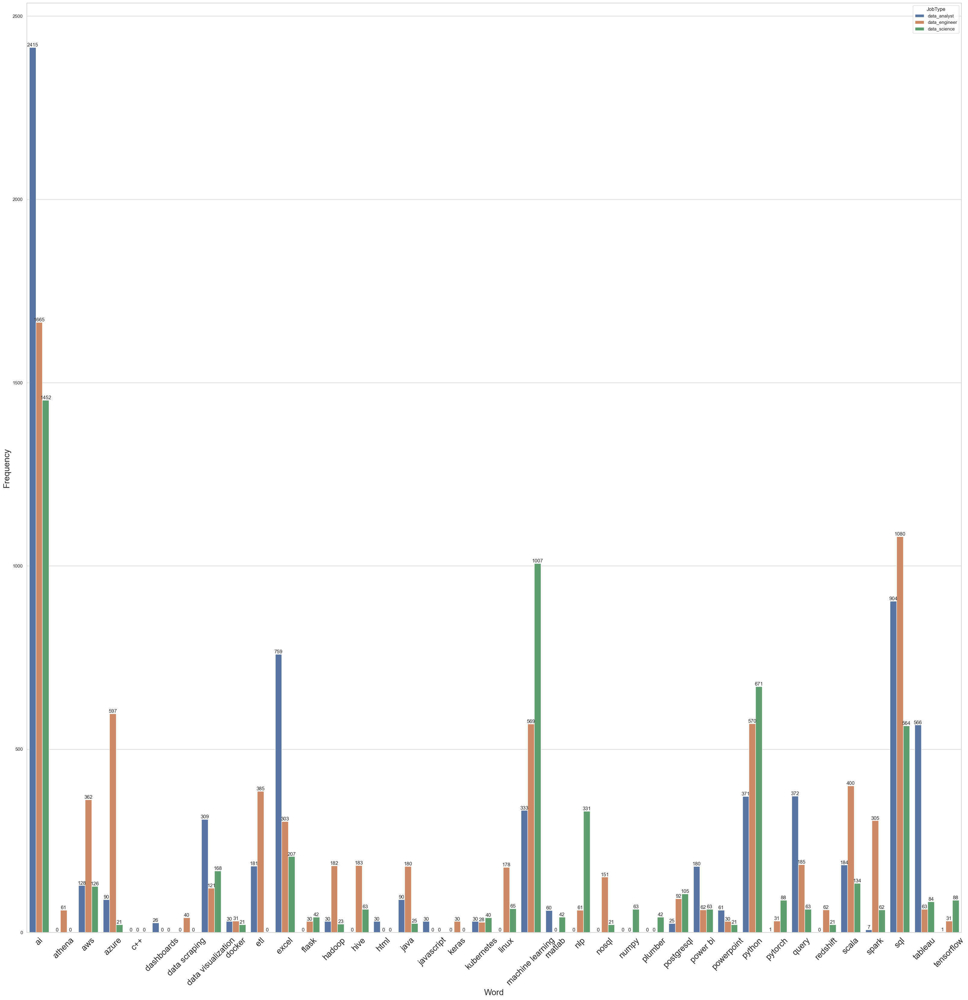

In [18]:
#group and sum frequency

grouped_data2 = dff2.groupby(['JobType', 'Word'], as_index=False)['Frequency'].sum()

sns.set(style="whitegrid")
plt.figure(figsize=(40, 40)) 
ax = sns.barplot(x='Word', y='Frequency', hue='JobType', data=grouped_data2)
for i in ax.containers:
    ax.bar_label(i,)
plt.xlabel('Word',fontsize=20)
plt.ylabel('Frequency',fontsize=20)
plt.xticks(rotation=45,fontsize = 20)
plt.show()

In [19]:
data_c = deepcopy(data_r)

# Convert the labels into numerical form
label_map = {'data_engineer': 0, 'data_science': 1, 'data_analyst': 2}
data_c['y_role'] = data_c['y_role'].map(label_map)
data_c.head()

,companyName,company_starRating,company_offeredRole,company_roleLocation,company_salary,listing_jobDesc,requested_url,y_role,cleaned_listing_jobDesc,Monthly_Salary,key_counts
0,Incube8 Pte Ltd,3.9,Data Engineer (Data Science),Novena,7500.0,"Maintain, build and iteratively improve existi...",https://www.glassdoor.sg/partner/jobListing.ht...,0,maintain build iteratively improve existing da...,7500.0,"{'sql': 2, 'python': 2, 'nosql': 0, 'postgresq..."
1,TRINITY CONSULTING SERVICES PTE. LTD.,4.1,Data Engineer,Singapore,7000.0,"Bachelors degree/Diploma in Computer Science,...",https://www.glassdoor.sg/partner/jobListing.ht...,0,bachelors degreediploma computer science comp...,7000.0,"{'sql': 2, 'python': 1, 'nosql': 0, 'postgresq..."
2,ELLIOTT MOSS CONSULTING PTE. LTD.,3.0,Data Engineer,Singapore,8000.0,The candidate for the Senior Data Engineer rol...,https://www.glassdoor.sg/partner/jobListing.ht...,0,candidate senior data engineer role must appro...,8000.0,"{'sql': 1, 'python': 1, 'nosql': 0, 'postgresq..."
3,DYNAMIC HUMAN CAPITAL PTE. LTD.,3.9,Data Engineer,Singapore,6000.0,Cooperates with DevOps and Business Intelligen...,https://www.glassdoor.sg/partner/jobListing.ht...,0,cooperates devops business intelligence team e...,6000.0,"{'sql': 3, 'python': 0, 'nosql': 1, 'postgresq..."
4,SAKSOFT PTE LIMITED,3.7,Data Engineer,Singapore,9000.0,Minimum 8 years of extensive experience in dea...,https://www.glassdoor.sg/partner/jobListing.ht...,0,minimum 8 year extensive experience dealing da...,9000.0,"{'sql': 1, 'python': 0, 'nosql': 0, 'postgresq..."


In [31]:
# Split the data into training, validation, and testing sets
train_df, test_df = train_test_split(data_c, test_size=0.2, random_state=4242)
train_df, val_df = train_test_split(train_df, test_size=0.2, random_state=4242)

# Create a feature representation for the job descriptions using a CountVectorizer
vectorizer = CountVectorizer()
X_train = vectorizer.fit_transform(train_df['cleaned_listing_jobDesc'])
X_val = vectorizer.transform(val_df['cleaned_listing_jobDesc'])
X_test = vectorizer.transform(test_df['cleaned_listing_jobDesc'])

# Create the target variable for each set
y_train = train_df['y_role']
y_val = val_df['y_role']
y_test = test_df['y_role']

#####
# Define the hyperparameter grid to search over
param_grid = {'alpha': [0.1, 0.5, 1.0, 2.0, 5.0, 10.0]}
#####
# Train a Multinomial Naive Bayes model with hyperparameter tuning
nb_model = MultinomialNB()
grid_search = GridSearchCV(nb_model, param_grid=param_grid, cv=5, n_jobs=-1, scoring='f1_weighted')
grid_search.fit(X_train, y_train)

# Print the best hyperparameters found by the grid search
print('Best Hyperparameters:', grid_search.best_params_)

# Make predictions on the validation set using the best model found
best_nb_model = grid_search.best_estimator_
y_pred = best_nb_model.predict(X_val)

# Evaluate the model's performance on the validation set

print('Accuracy-valid:', accuracy_score(y_val, y_pred))
print('Precision-valid:', precision_score(y_val, y_pred, average='weighted'))
print('Recall-valid:', recall_score(y_val, y_pred, average='weighted'))
print('F1 Score-valid:', f1_score(y_val, y_pred, average='weighted'))

# Make predictions on the test set using the best model found
y_pred = best_nb_model.predict(X_test)

# Evaluate the model's performance on the test set
print('Accuracy-test:', accuracy_score(y_test, y_pred))
print('Precision-test:', precision_score(y_test, y_pred, average='weighted'))
print('Recall-test:', recall_score(y_test, y_pred, average='weighted'))
print('F1 Score-test:', f1_score(y_test, y_pred, average='weighted'))


Best Hyperparameters: {'alpha': 5.0}
Accuracy-valid: 0.9203084832904884
Precision-valid: 0.9229834864796304
Recall-valid: 0.9203084832904884
F1 Score-valid: 0.9209493929080383
Accuracy-test: 0.9053497942386831
Precision-test: 0.9086295127393244
Recall-test: 0.9053497942386831
F1 Score-test: 0.906207666926018


In [33]:
#Random Forest Classifier


# Split the data into training, validation, and test sets
#train_data, test_data, train_labels, test_labels = train_test_split(data['clean_job_desc'], data['y_role'], test_size=0.2, random_state=42)
#train_data, valid_data, train_labels, valid_labels = train_test_split(train_data, train_labels, test_size=0.2, random_state=42)

# Vectorize the data using TF-IDF vectorizer
#vectorizer = TfidfVectorizer()
#train_vectors = vectorizer.fit_transform(train_data)
#valid_vectors = vectorizer.transform(valid_data)
#test_vectors = vectorizer.transform(test_data)

# Define the hyperparameter grid to search over
param_grid = {
    'n_estimators': [50, 100, 200],
    'max_depth': [10, 20, 30],
    'min_samples_split': [2, 5, 10]
}

# Train the Random Forest Classifier using Grid Search Cross Validation
rfc = RandomForestClassifier(random_state=4242)
grid_search_rf = GridSearchCV(estimator=rfc, param_grid=param_grid, cv=5)
grid_search_rf.fit(X_train, y_train)

# Print the best hyperparameters
print("Best hyperparameters: ", grid_search_rf.best_params_)

y_pred_rf = grid_search_rf.predict(X_val)

# Evaluate the model's performance on the validation set
print('Accuracy-valid(Random Forest):', accuracy_score(y_val, y_pred_rf))
print('Precision-valid(Random Forest):', precision_score(y_val, y_pred_rf, average='weighted'))
print('Recall-valid(Random Forest):', recall_score(y_val, y_pred_rf, average='weighted'))
print('F1 Score-valid(Random Forest):', f1_score(y_val, y_pred_rf, average='weighted'))

# Make predictions on the test set using the best model found
y_pred_rf = grid_search_rf.predict(X_test)

# Evaluate the model's performance on the test set
print('Accuracy-test(Random Forest):', accuracy_score(y_test, y_pred_rf))
print('Precision-test(Random Forest):', precision_score(y_test, y_pred_rf, average='weighted'))
print('Recall-test(Random Forest):', recall_score(y_test, y_pred_rf, average='weighted'))
print('F1 Score-test(Random Forest):', f1_score(y_test, y_pred_rf, average='weighted'))



Best hyperparameters:  {'max_depth': 20, 'min_samples_split': 2, 'n_estimators': 200}
Accuracy-valid(Random Forest): 0.9485861182519281
Precision-valid(Random Forest): 0.9481063099123184
Recall-valid(Random Forest): 0.9485861182519281
F1 Score-valid(Random Forest): 0.9481739493787724
Accuracy-test(Random Forest): 0.9403292181069959
Precision-test(Random Forest): 0.9399773250562986
Recall-test(Random Forest): 0.9403292181069959
F1 Score-test(Random Forest): 0.9395655147200571


In [36]:
###Neural Network
###NOTE THIS CELL TAKES A WHILE TO RUN (20 mins avg i think)
# Define the MLP neural network architecture
model = MLPClassifier(random_state=4242)



param_grid = {
    'hidden_layer_sizes': [(64,), (128,), (256,)],
    'activation': ['relu', 'tanh'],
    'solver': ['adam', 'sgd'],
    'max_iter': [250, 500]
}

# Define the grid search object
grid_searchnn = GridSearchCV(model, param_grid, cv=3)

# Fit the grid search object to the training data
grid_searchnn.fit(X_train, y_train)

# Get the best model and print its parameters
best_model = grid_searchnn.best_estimator_
print(f"Best Model: {best_model}\n")

y_pred_nn = grid_searchnn.predict(X_val)
# Evaluate the model's performance on the validation set
print('Accuracy-valid(Random Forest):', accuracy_score(y_val, y_pred_nn))
print('Precision-valid(Random Forest):', precision_score(y_val, y_pred_nn, average='weighted'))
print('Recall-valid(Random Forest):', recall_score(y_val, y_pred_nn, average='weighted'))
print('F1 Score-valid(Random Forest):', f1_score(y_val, y_pred_nn, average='weighted'))

# Make predictions on the test set using the best model found
y_pred_nn = grid_searchnn.predict(X_test)
# Evaluate the model's performance on the test set
print('Accuracy-test(Random Forest):', accuracy_score(y_test, y_pred_nn))
print('Precision-test(Random Forest):', precision_score(y_test, y_pred_nn, average='weighted'))
print('Recall-test(Random Forest):', recall_score(y_test, y_pred_nn, average='weighted'))
print('F1 Score-test(Random Forest):', f1_score(y_test, y_pred_nn, average='weighted'))

C:\Users\JeeJoo\anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:702: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (250) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\JeeJoo\anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:702: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (250) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\JeeJoo\anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:702: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (250) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\JeeJoo\anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:702: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (250) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\JeeJoo\anaconda3\lib\site-packages\sklearn\neural_network\_

Best Model: MLPClassifier(activation='tanh', hidden_layer_sizes=(256,), max_iter=250,
              random_state=4242)

Accuracy-valid(Random Forest): 0.9434447300771208
Precision-valid(Random Forest): 0.9439347392110888
Recall-valid(Random Forest): 0.9434447300771208
F1 Score-valid(Random Forest): 0.9432394942228639
Accuracy-test(Random Forest): 0.9300411522633745
Precision-test(Random Forest): 0.9314558980532269
Recall-test(Random Forest): 0.9300411522633745
F1 Score-test(Random Forest): 0.9298639636290994


In [42]:
def metric_row(true,pred,index):
  metrics_names=['Precision', 'Recall', 'F1', 'Accuracy']
  prec = precision_score(true,pred,average='weighted')
  rec = recall_score(true,pred,average='weighted')
  f1 = f1_score(true,pred,average='weighted')
  acc = accuracy_score(true,pred)
  met = pd.DataFrame([[prec,rec,f1,acc]],
                            index=[index], 
                            columns=metrics_names)
  return met


NB_met = metric_row(y_test,y_pred,'Multonomial Naive Bayes')
RF_met = metric_row(y_test,y_pred_rf,'Random Forest Bayes')
NN_met = metric_row(y_test,y_pred_nn,'Neural Network')

all_metrics = NB_met.append(RF_met).append(NN_met)
all_metrics

<ipython-input-42-5a73a1212691>:17: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_metrics = NB_met.append(RF_met).append(NN_met)
<ipython-input-42-5a73a1212691>:17: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_metrics = NB_met.append(RF_met).append(NN_met)


,Precision,Recall,F1,Accuracy
Multonomial Naive Bayes,0.908630,0.905350,0.906208,0.905350
Random Forest Bayes,0.939977,0.940329,0.939566,0.940329
Neural Network,0.931456,0.930041,0.929864,0.930041
